In [41]:
import time
import random
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [42]:
# Input array sizes for benchmarking
test_small = [100, 200, 500, 1000, 1500, 2000, 2500]
test_medium = [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
test_large = [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
test_xl = [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
test_xxl = [500000, 600000, 700000, 800000, 900000, 1000000] # somehow laptop isn't dying
test_xxxl = [1500000, 2000000, 2500000, 5000000, 7500000, 10000000] # Spasi i sohrani
test_xxxxl = [15000000, 20000000, 25000000, 50000000, 75000000, 100000000] # Skoliko mojno!?

# Array generators
def generate_random_array(n):
    # Random integers in [0, n * 10]
    return [random.randint(0, n * 10) for _ in range(n)]

def generate_sorted_array(n):
    # Already sorted array (best case for some, worst for others)
    return list(range(n))

def generate_reverse_sorted_array(n):
    # Reverse sorted array
    return list(range(n, 0, -1))

In [43]:
def counting_sort_with_keys(A, B, C, K, copy_B_to_A):
    """
    Counting Sort using externally provided keys.
    A - input array
    B - auxiliary array (same size as A)
    C - counting array (size = key range)
    K - key array (same size as A)
    copy_B_to_A - if True copy sorted B back to A
    """

    n = len(A)

    # Reset counting array
    for i in range(len(C)):
        C[i] = 0

    # Count occurrences
    for i in range(n):
        k = K[i]
        C[k] += 1

    # Prefix sums
    for k in range(1, len(C)):
        C[k] += C[k - 1]

    # Build output (stable)
    for i in range(n - 1, -1, -1):
        k = K[i]
        B[C[k] - 1] = A[i]
        C[k] -= 1

    # copy back
    if copy_B_to_A:
        for i in range(n):
            A[i] = B[i]

In [44]:
def qr_sort(A, d):
    """
    QR Sort using divisor d.
    Sorts using remainder then quotient (stable).
    """

    n = len(A)
    if n <= 1:
        return A

    min_a = min(A)
    max_a = max(A)

    max_quot = (max_a - min_a) // d

    B = [0] * n

    # Remainder keys
    Cr = [0] * d
    R = []
    for v in A:
        R.append((v - min_a) % d)

    if max_quot == 0:
        counting_sort_with_keys(A, B, Cr, R, True)
        return A

    # First pass: sort by remainder into B
    counting_sort_with_keys(A, B, Cr, R, False)

    # Quotient keys
    min_b = min(B)
    Q = []
    for v in B:
        Q.append((v - min_b) // d)

    max_q = max(Q)
    Cq = [0] * (max_q + 1)

    # Second pass: sort by quotient into A
    counting_sort_with_keys(B, A, Cq, Q, False)

    return A


In [45]:
def merge(arr, l, m, r):
    n1 = m - l + 1
    n2 = r - m

    L = [0] * n1
    R = [0] * n2

    for i in range(n1):
        L[i] = arr[l + i]
    for j in range(n2):
        R[j] = arr[m + 1 + j]

    i = j = 0
    k = l

    while i < n1 and j < n2:
        if L[i] <= R[j]:
            arr[k] = L[i]
            i += 1
        else:
            arr[k] = R[j]
            j += 1
        k += 1

    while i < n1:
        arr[k] = L[i]
        i += 1
        k += 1
    while j < n2:
        arr[k] = R[j]
        j += 1
        k += 1

def mergeSort(arr, l, r):
    if l < r:
        m = l + (r - l) // 2
        mergeSort(arr, l, m)
        mergeSort(arr, m + 1, r)
        merge(arr, l, m, r)

In [46]:
def partition(arr, low, high):
    pivot = arr[high]
    i = low - 1
    for j in range(low, high):
        if arr[j] <= pivot:
            i += 1
            arr[i], arr[j] = arr[j], arr[i]
    arr[i + 1], arr[high] = arr[high], arr[i + 1]
    return i + 1

def quick_sort(arr, low, high):
    if low < high:
        p = partition(arr, low, high)
        quick_sort(arr, low, p - 1)
        quick_sort(arr, p + 1, high)

In [47]:
def heapify(arr, n, i):
    largest = i    
    l = 2 * i + 1    
    r = 2 * i + 2  

    if l < n and arr[l] > arr[largest]:
        largest = l

    if r < n and arr[r] > arr[largest]:
        largest = r

    if largest != i:
        arr[i], arr[largest] = arr[largest], arr[i]
        heapify(arr, n, largest)

def heapSort(arr):
    n = len(arr)

    for i in range(n // 2 - 1, -1, -1):
        heapify(arr, n, i)

    for i in range(n - 1, 0, -1):
        arr[i], arr[0] = arr[0], arr[i]  # Swap max to end
        heapify(arr, i, 0)

In [48]:
# Sorting Network helpers (you can extend networks here)
# Networks are lists of comparator pairs (i, j) using 0-based indices inside the subarray.

SORTING_NETWORKS = {
    # size 2
    2: [(0, 1)],
    # size 3 (simple)
    3: [(0, 1), (1, 2), (0, 1)],
    # size 4 (bitonic network)
    4: [(0, 1), (2, 3), (0, 2), (1, 3), (1, 2)],
    # size 5 (works, not minimal)
    5: [(0, 1), (3, 4), (2, 4), (2, 3),
        (0, 3), (0, 2), (1, 4), (1, 3), (1, 2)],
    # size 8 (classic bitonic sorting network)
    8: [
        (0, 1), (2, 3), (4, 5), (6, 7),
        (0, 2), (1, 3), (4, 6), (5, 7),
        (1, 2), (5, 6), (0, 4), (1, 5), (2, 6), (3, 7),
        (2, 4), (3, 5),
        (1, 2), (3, 4), (5, 6),
    ],
}

In [49]:
def apply_sorting_network(arr, left, right):
    size = right - left + 1
    net = SORTING_NETWORKS.get(size)
    if net is None:
        return False  # no network for this size
    for i, j in net:
        a = left + i
        b = left + j
        if arr[a] > arr[b]:
            arr[a], arr[b] = arr[b], arr[a]
    return True

In [50]:
# Optimized Merge Sort with Sorting Networks
def _merge(arr, left, mid, right):
    temp = []
    i, j = left, mid + 1

    while i <= mid and j <= right:
        if arr[i] <= arr[j]:
            temp.append(arr[i])
            i += 1
        else:
            temp.append(arr[j])
            j += 1

    while i <= mid:
        temp.append(arr[i])
        i += 1
    while j <= right:
        temp.append(arr[j])
        j += 1

    for k in range(len(temp)):
        arr[left + k] = temp[k]


def optimized_merge_sort(arr, left=0, right=None):
    if right is None:
        right = len(arr) - 1
    if left >= right:
        return

    size = right - left + 1
    if size in SORTING_NETWORKS:
        apply_sorting_network(arr, left, right)
        return

    mid = left + (right - left) // 2
    optimized_merge_sort(arr, left, mid)
    optimized_merge_sort(arr, mid + 1, right)
    _merge(arr, left, mid, right)

In [51]:
# Optimized Quick Sort with Sorting Networks

def _median_of_three_index(arr, low, high):
    mid = low + (high - low) // 2
    a, b, c = low, mid, high

    # Return index of median value among arr[a], arr[b], arr[c]
    if arr[a] < arr[b]:
        if arr[b] < arr[c]:
            return b
        return c if arr[a] < arr[c] else a
    else:
        if arr[a] < arr[c]:
            return a
        return c if arr[b] < arr[c] else b


def _hoare_partition(arr, low, high, pivot_index):
    pivot = arr[pivot_index]
    i = low - 1
    j = high + 1

    while True:
        i += 1
        while arr[i] < pivot:
            i += 1

        j -= 1
        while arr[j] > pivot:
            j -= 1

        if i >= j:
            return j

        arr[i], arr[j] = arr[j], arr[i]


def optimized_quick_sort(arr, low=0, high=None):
    if high is None:
        high = len(arr) - 1
    if low >= high:
        return

    size = high - low + 1
    if size in SORTING_NETWORKS:
        apply_sorting_network(arr, low, high)
        return

    pivot_index = _median_of_three_index(arr, low, high)
    p = _hoare_partition(arr, low, high, pivot_index)
    optimized_quick_sort(arr, low, p)
    optimized_quick_sort(arr, p + 1, high)


In [52]:
class Alg:
    # Wrapper functions for uniform interface
    def run_qr(arr):
        d = max(int(len(arr) ** 0.5), 2)
        qr_sort(arr, d)

    def run_merge(arr):
        mergeSort(arr, 0, len(arr) - 1)

    def run_quick(arr):
        quick_sort(arr, 0, len(arr) - 1)

    def run_heap(arr):
        heapSort(arr)

    def run_optimized_merge(arr):
        optimized_merge_sort(arr)

    def run_optimized_quick(arr):
        optimized_quick_sort(arr)


def compare_and_plot(test_name, sizes, algorithms, generator, generator_name):
    """
    Benchmarks sorting algorithms on arrays of given sizes.
    algorithms: list of (name, function) tuples
    generator: function(n) -> array of size n
    """
    results = {name: [] for name, _ in algorithms}

    print(f"\n!!! Running {test_name} | Input: {generator_name}")
    print(f"Sizes: {sizes}")
    print(f"Algorithms: {[name for name, _ in algorithms]}")

    for n in sizes:
        base_arr = generator(n)
        for name, func in algorithms:
            arr_copy = base_arr[:] 
            start = time.perf_counter_ns()
            func(arr_copy)
            end = time.perf_counter_ns()
            elapsed_s = (end - start) / 1e9
            results[name].append((n, elapsed_s))

    # Plot
    fig, ax = plt.subplots(figsize=(12, 7))
    for name, times in results.items():
        ns = [n for n, t in times]
        ts = [t for n, t in times]
        ax.plot(ns, ts, marker='o', markersize=4, linewidth=1.5, label=name)

    ax.set_xlabel('Array Size (n)', fontsize=12)
    ax.set_ylabel('Time (seconds)', fontsize=12)
    ax.set_title(f'Sorting Algorithm Performance - {test_name} ({generator_name})', fontsize=14)
    ax.legend(loc='best', fontsize=10)
    ax.grid(True, which='both', linestyle='--', alpha=0.7)

    ax.yaxis.set_major_formatter(ticker.ScalarFormatter(useMathText=True))
    ax.ticklabel_format(style='scientific', axis='y', scilimits=(0, 0))
    ax.yaxis.get_offset_text().set_fontsize(10)

    ax.minorticks_on()
    ax.grid(True, which='minor', linestyle=':', alpha=0.4)

    plt.tight_layout()
    plt.show()

    # Print summary
    print(f"\n Summary for {test_name} ({generator_name}) ")
    for name, times in results.items():
        ts = [t for n, t in times]
        avg_time = sum(ts) / len(ts)
        min_time = min(ts)
        max_time = max(ts)
        print(f"{name}: avg={avg_time:.6e}s, min={min_time:.6e}s, max={max_time:.6e}s")

#  RANDOM INPUT - All 6 algorithms on all 6 test sets

!!! Running test_small | Input: Random
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


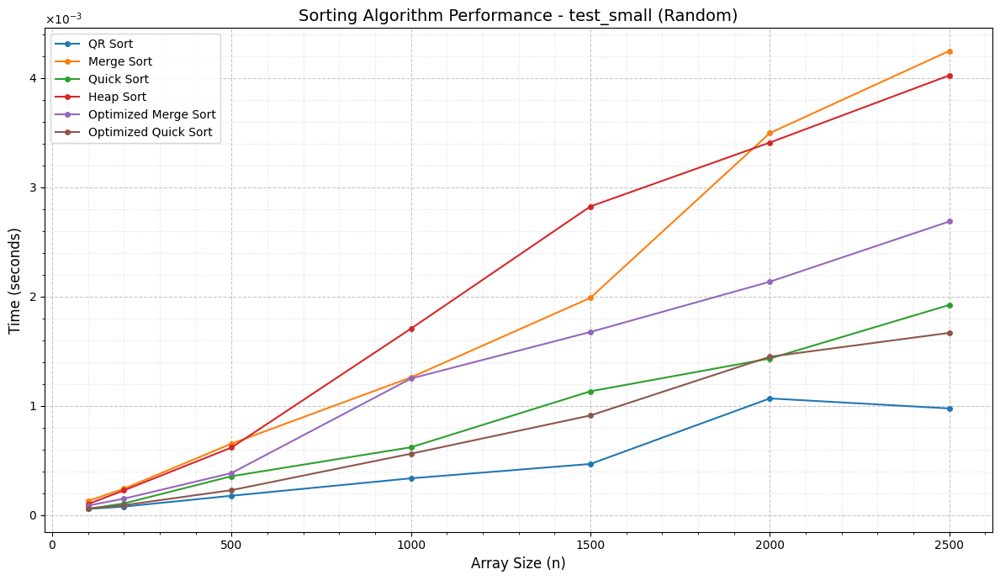


 Summary for test_small (Random) 
QR Sort: avg=4.504286e-04s, min=5.520000e-05s, max=1.067200e-03s
Merge Sort: avg=1.716314e-03s, min=1.291000e-04s, max=4.248400e-03s
Quick Sort: avg=8.033286e-04s, min=5.640000e-05s, max=1.922800e-03s
Heap Sort: avg=1.843786e-03s, min=9.960000e-05s, max=4.024600e-03s
Optimized Merge Sort: avg=1.195043e-03s, min=8.580000e-05s, max=2.687100e-03s
Optimized Quick Sort: avg=7.087857e-04s, min=5.680000e-05s, max=1.667200e-03s

!!! Running test_medium | Input: Random
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


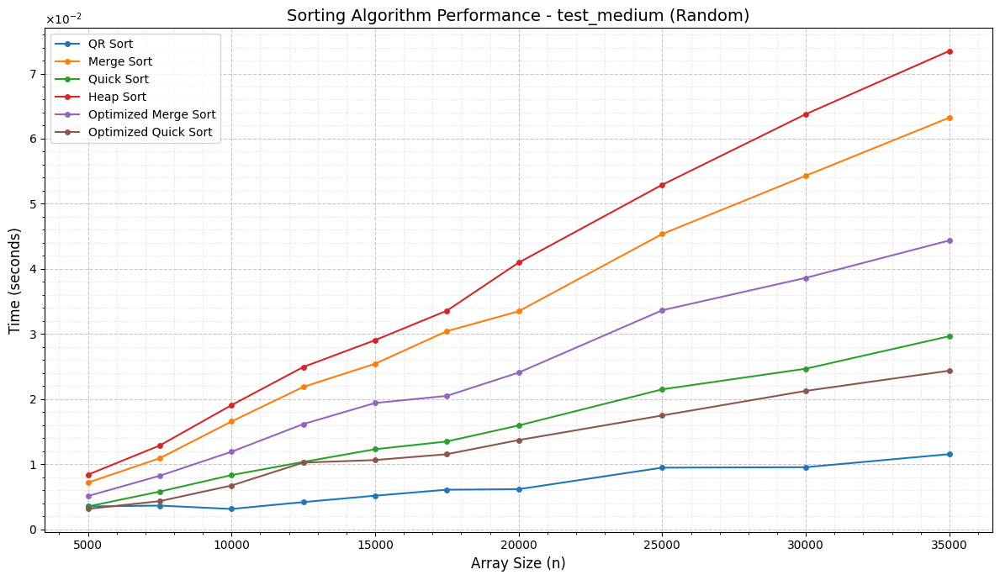


 Summary for test_medium (Random) 
QR Sort: avg=6.224070e-03s, min=3.108000e-03s, max=1.152900e-02s
Merge Sort: avg=3.086157e-02s, min=7.153000e-03s, max=6.322400e-02s
Quick Sort: avg=1.453744e-02s, min=3.486700e-03s, max=2.964680e-02s
Heap Sort: avg=3.588869e-02s, min=8.369500e-03s, max=7.347850e-02s
Optimized Merge Sort: avg=2.218551e-02s, min=5.087100e-03s, max=4.436170e-02s
Optimized Quick Sort: avg=1.232584e-02s, min=3.119200e-03s, max=2.435050e-02s

!!! Running test_large | Input: Random
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


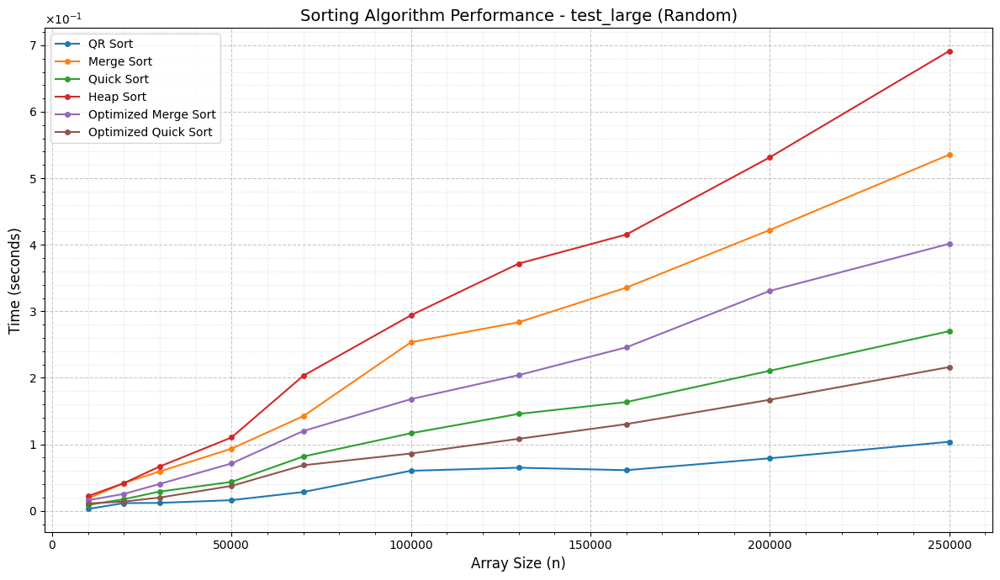


 Summary for test_large (Random) 
QR Sort: avg=4.398450e-02s, min=2.843600e-03s, max=1.038406e-01s
Merge Sort: avg=2.186049e-01s, min=1.853640e-02s, max=5.355878e-01s
Quick Sort: avg=1.087276e-01s, min=8.823700e-03s, max=2.701905e-01s
Heap Sort: avg=2.748036e-01s, min=2.202270e-02s, max=6.915092e-01s
Optimized Merge Sort: avg=1.623239e-01s, min=1.586790e-02s, max=4.015613e-01s
Optimized Quick Sort: avg=8.590430e-02s, min=1.105650e-02s, max=2.162115e-01s

!!! Running test_xl | Input: Random
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


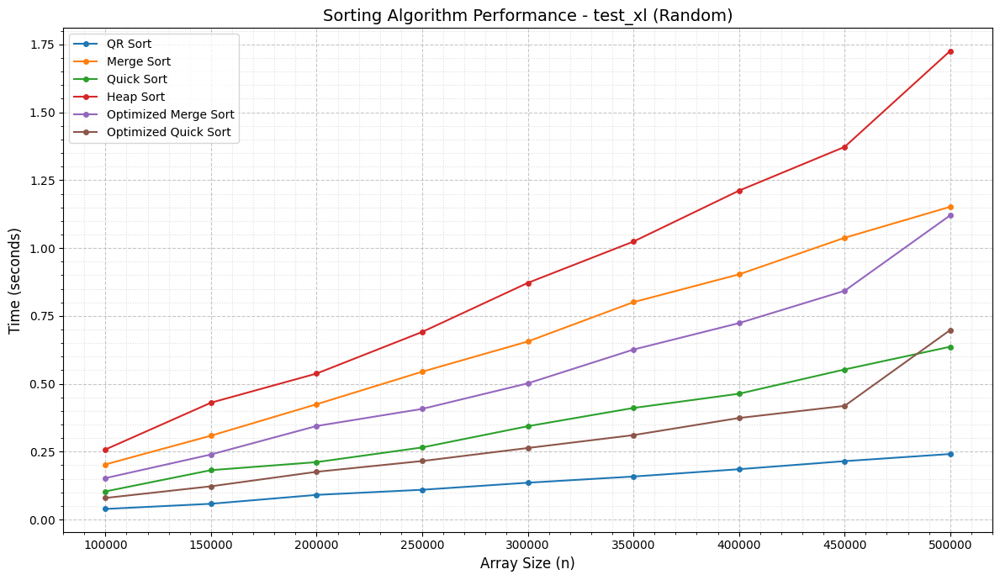


 Summary for test_xl (Random) 
QR Sort: avg=1.369980e-01s, min=3.893310e-02s, max=2.413452e-01s
Merge Sort: avg=6.700559e-01s, min=2.029588e-01s, max=1.151958e+00s
Quick Sort: avg=3.521636e-01s, min=1.034907e-01s, max=6.364480e-01s
Heap Sort: avg=9.025477e-01s, min=2.579746e-01s, max=1.726163e+00s
Optimized Merge Sort: avg=5.509247e-01s, min=1.525052e-01s, max=1.120559e+00s
Optimized Quick Sort: avg=2.953409e-01s, min=7.942150e-02s, max=6.979586e-01s

!!! Running test_xxl | Input: Random
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


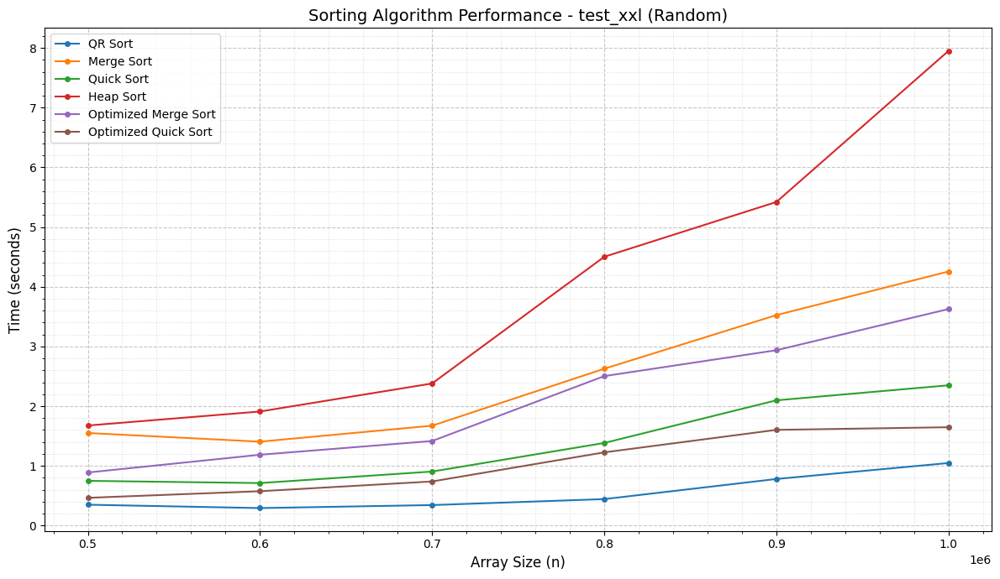


 Summary for test_xxl (Random) 
QR Sort: avg=5.425992e-01s, min=2.927855e-01s, max=1.047345e+00s
Merge Sort: avg=2.506041e+00s, min=1.405279e+00s, max=4.255838e+00s
Quick Sort: avg=1.366000e+00s, min=7.116743e-01s, max=2.349505e+00s
Heap Sort: avg=3.973366e+00s, min=1.675833e+00s, max=7.951930e+00s
Optimized Merge Sort: avg=2.092954e+00s, min=8.885865e-01s, max=3.626731e+00s
Optimized Quick Sort: avg=1.042343e+00s, min=4.644960e-01s, max=1.647133e+00s

!!! Running test_xxl | Input: Random
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


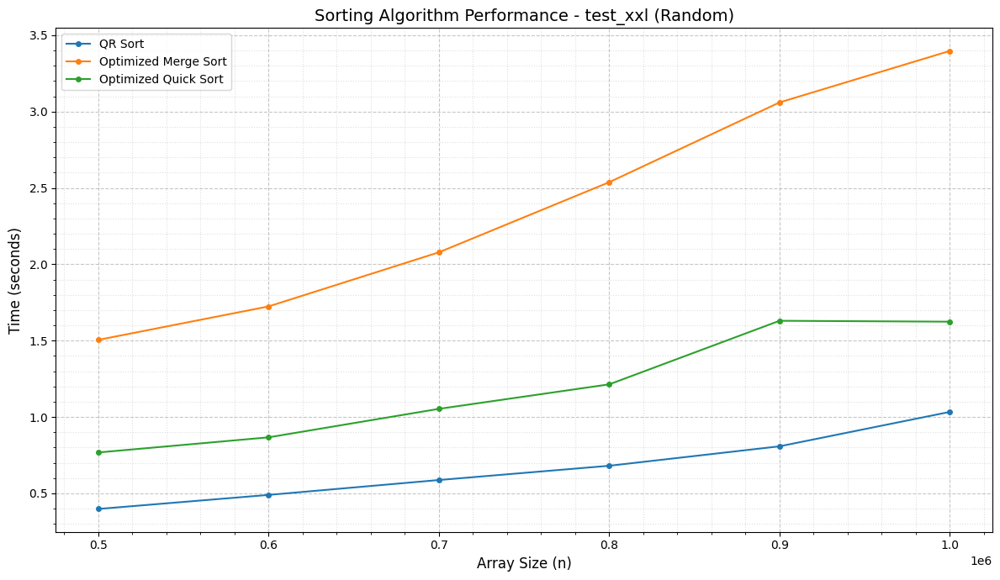


 Summary for test_xxl (Random) 
QR Sort: avg=6.662553e-01s, min=3.979060e-01s, max=1.033437e+00s
Optimized Merge Sort: avg=2.383930e+00s, min=1.505215e+00s, max=3.397388e+00s
Optimized Quick Sort: avg=1.192782e+00s, min=7.678763e-01s, max=1.630192e+00s

!!! Running test_xxxl | Input: Random
Sizes: [1500000, 2000000, 2500000, 5000000, 7500000, 10000000]
Algorithms: ['QR Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


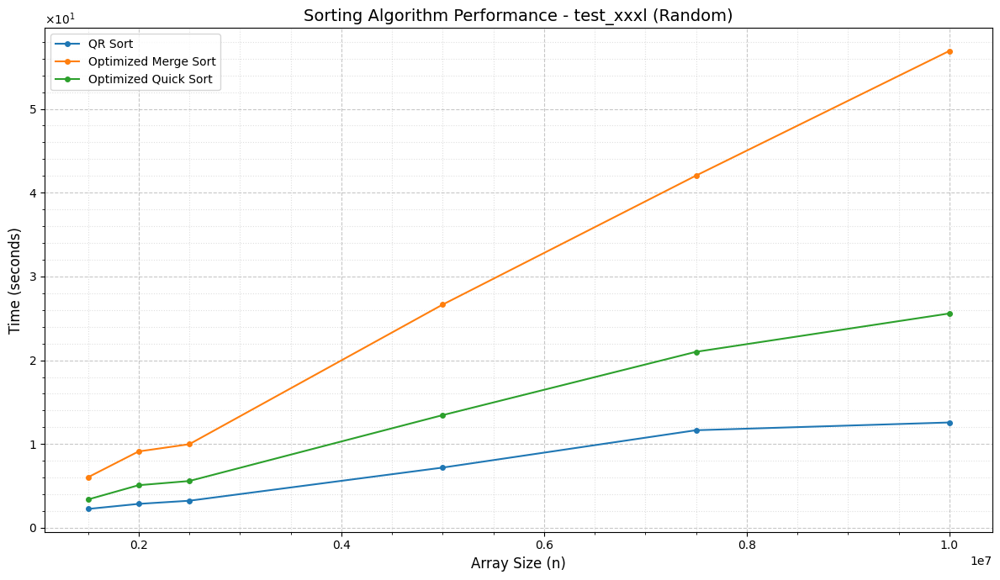


 Summary for test_xxxl (Random) 
QR Sort: avg=6.626378e+00s, min=2.253694e+00s, max=1.257460e+01s
Optimized Merge Sort: avg=2.511975e+01s, min=6.028625e+00s, max=5.691724e+01s
Optimized Quick Sort: avg=1.234883e+01s, min=3.380768e+00s, max=2.558349e+01s
#  SORTED INPUT (ascending) - All 6 algorithms on all 6 test sets
#  Note: Basic Quick Sort included only on test_small (O(n^2) worst case)

!!! Running test_small | Input: Sorted (ascending)
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


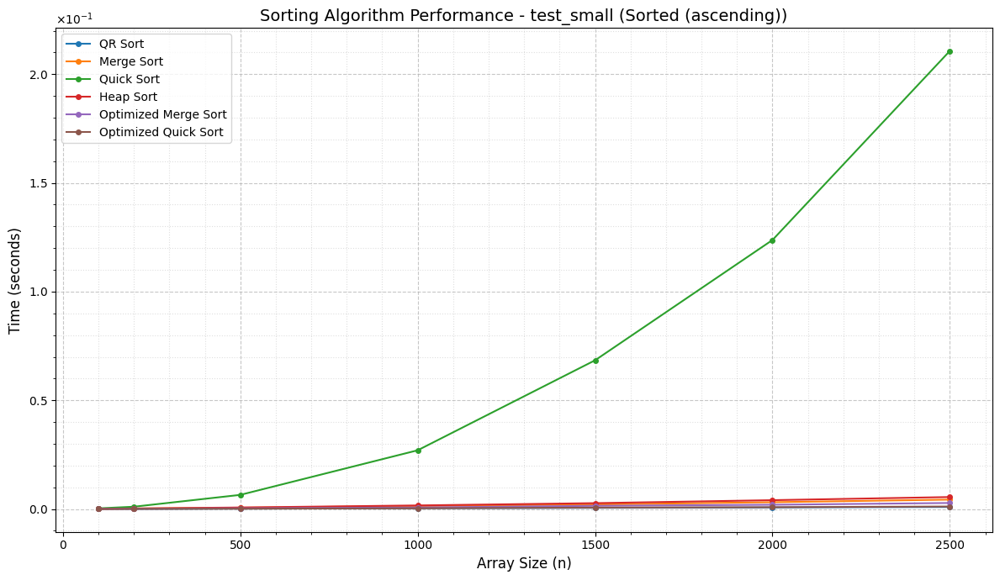


 Summary for test_small (Sorted (ascending)) 
QR Sort: avg=4.051143e-04s, min=4.610000e-05s, max=9.427000e-04s
Merge Sort: avg=1.700343e-03s, min=1.077000e-04s, max=4.326600e-03s
Quick Sort: avg=6.253387e-02s, min=3.038000e-04s, max=2.107125e-01s
Heap Sort: avg=2.141100e-03s, min=1.035000e-04s, max=5.509800e-03s
Optimized Merge Sort: avg=1.064143e-03s, min=6.150000e-05s, max=2.781800e-03s
Optimized Quick Sort: avg=4.617714e-04s, min=3.150000e-05s, max=1.160300e-03s

!!! Running test_medium | Input: Sorted (ascending)
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


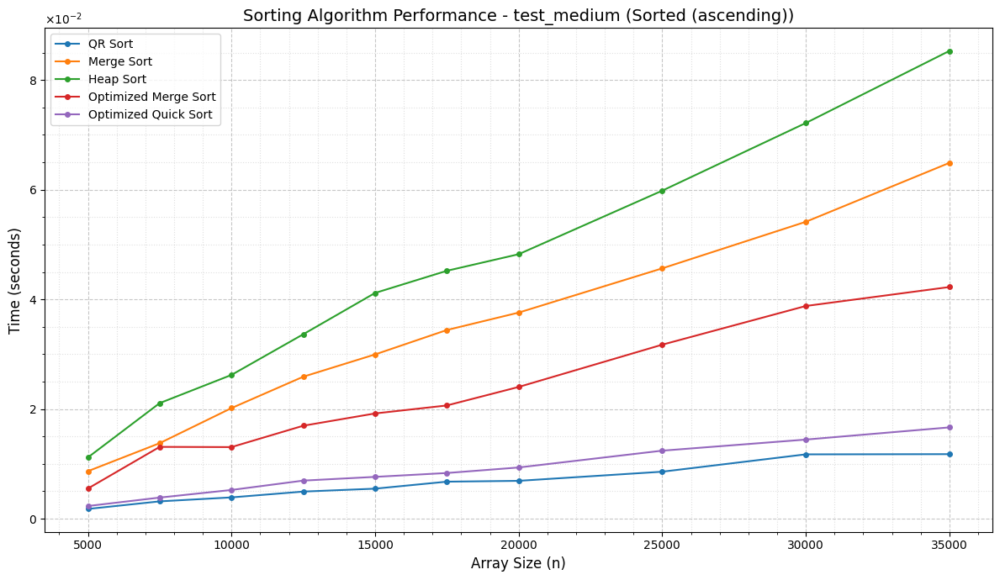


 Summary for test_medium (Sorted (ascending)) 
QR Sort: avg=6.494510e-03s, min=1.773300e-03s, max=1.176900e-02s
Merge Sort: avg=3.351088e-02s, min=8.661100e-03s, max=6.488880e-02s
Heap Sort: avg=4.439731e-02s, min=1.116660e-02s, max=8.530700e-02s
Optimized Merge Sort: avg=2.252210e-02s, min=5.498100e-03s, max=4.224620e-02s
Optimized Quick Sort: avg=8.710090e-03s, min=2.307600e-03s, max=1.664910e-02s

!!! Running test_large | Input: Sorted (ascending)
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


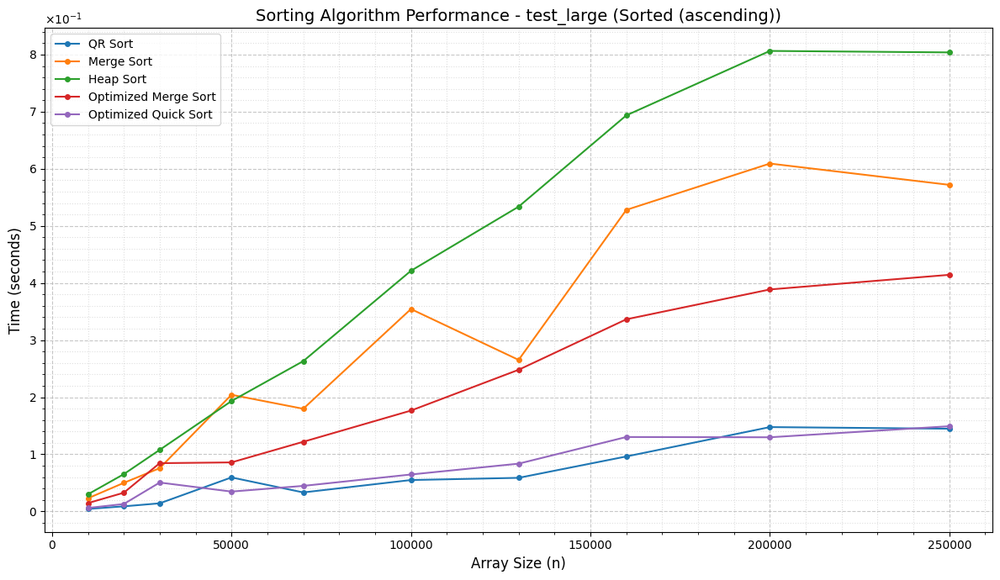


 Summary for test_large (Sorted (ascending)) 
QR Sort: avg=6.221249e-02s, min=4.252400e-03s, max=1.476231e-01s
Merge Sort: avg=2.861182e-01s, min=2.288740e-02s, max=6.091932e-01s
Heap Sort: avg=3.918165e-01s, min=2.985800e-02s, max=8.064515e-01s
Optimized Merge Sort: avg=1.903215e-01s, min=1.449090e-02s, max=4.143254e-01s
Optimized Quick Sort: avg=7.061077e-02s, min=5.978600e-03s, max=1.491628e-01s

!!! Running test_xl | Input: Sorted (ascending)
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


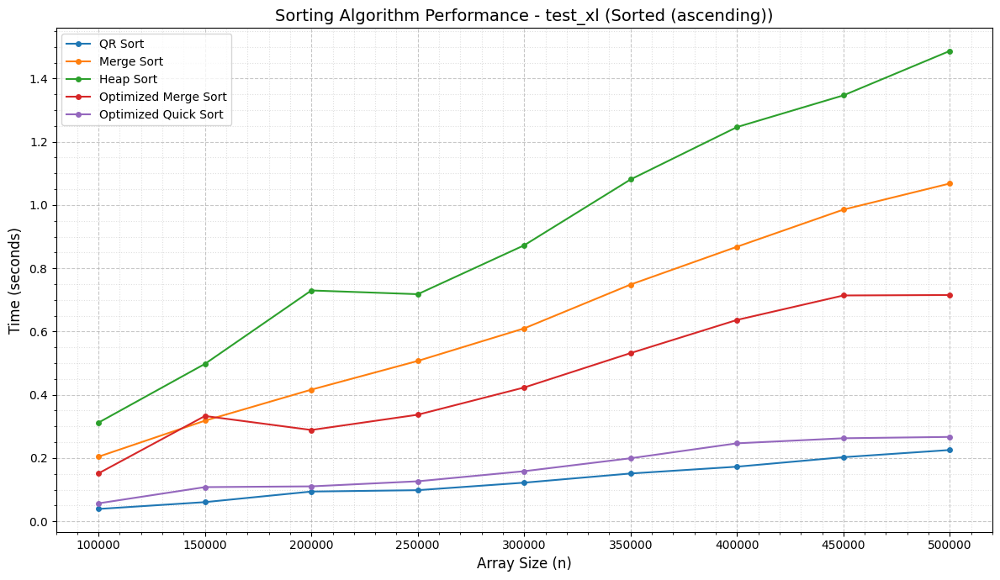


 Summary for test_xl (Sorted (ascending)) 
QR Sort: avg=1.296488e-01s, min=3.910800e-02s, max=2.254909e-01s
Merge Sort: avg=6.362867e-01s, min=2.043630e-01s, max=1.068130e+00s
Heap Sort: avg=9.213460e-01s, min=3.121156e-01s, max=1.487248e+00s
Optimized Merge Sort: avg=4.590979e-01s, min=1.516752e-01s, max=7.154973e-01s
Optimized Quick Sort: avg=1.706857e-01s, min=5.685820e-02s, max=2.668820e-01s

!!! Running test_xxl | Input: Sorted (ascending)
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


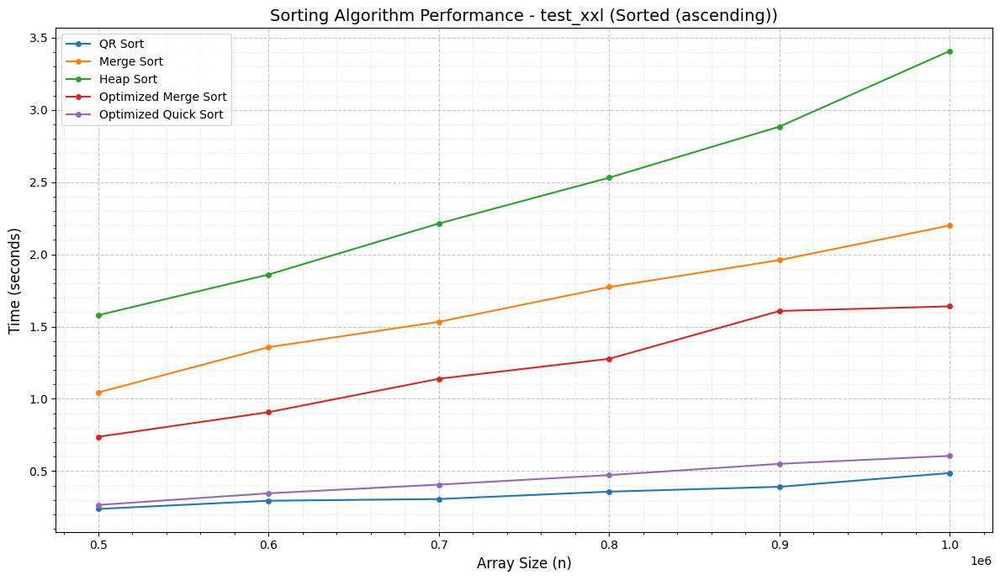


 Summary for test_xxl (Sorted (ascending)) 
QR Sort: avg=3.457324e-01s, min=2.378404e-01s, max=4.864039e-01s
Merge Sort: avg=1.644934e+00s, min=1.044175e+00s, max=2.200139e+00s
Heap Sort: avg=2.413014e+00s, min=1.579152e+00s, max=3.408357e+00s
Optimized Merge Sort: avg=1.218373e+00s, min=7.373596e-01s, max=1.640219e+00s
Optimized Quick Sort: avg=4.409022e-01s, min=2.653447e-01s, max=6.051523e-01s
#  REVERSE SORTED INPUT (descending) - All 6 algorithms on all 6 test sets
#  Note: Basic Quick Sort included only on test_small (O(n^2) worst case)

!!! Running test_small | Input: Reverse sorted
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


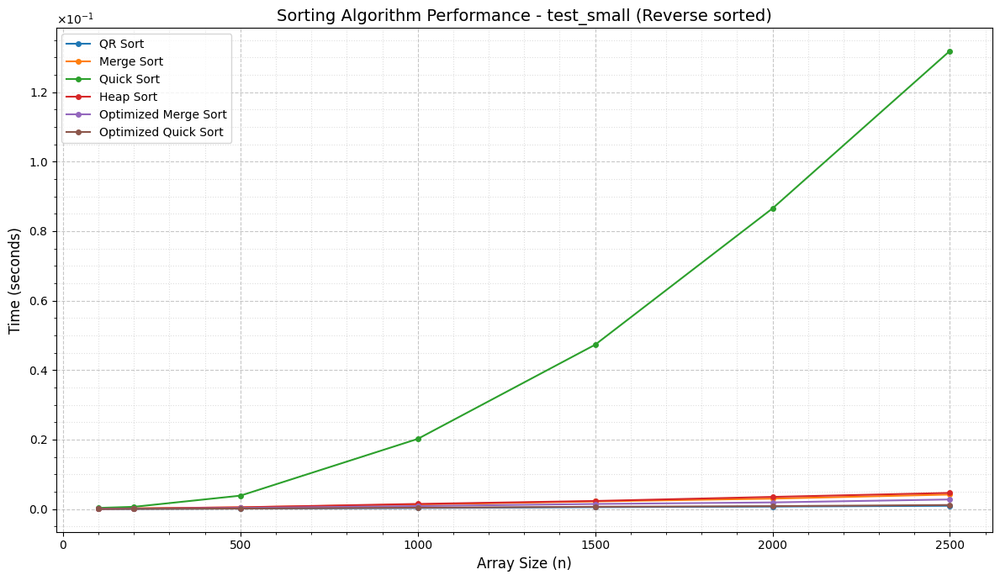


 Summary for test_small (Reverse sorted) 
QR Sort: avg=3.941429e-04s, min=4.100000e-05s, max=9.408000e-04s
Merge Sort: avg=1.644229e-03s, min=1.007000e-04s, max=4.182600e-03s
Quick Sort: avg=4.153150e-02s, min=3.305000e-04s, max=1.318578e-01s
Heap Sort: avg=1.819514e-03s, min=8.920000e-05s, max=4.651100e-03s
Optimized Merge Sort: avg=1.071543e-03s, min=5.890000e-05s, max=2.763200e-03s
Optimized Quick Sort: avg=4.738714e-04s, min=3.240000e-05s, max=1.173500e-03s

!!! Running test_medium | Input: Reverse sorted
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


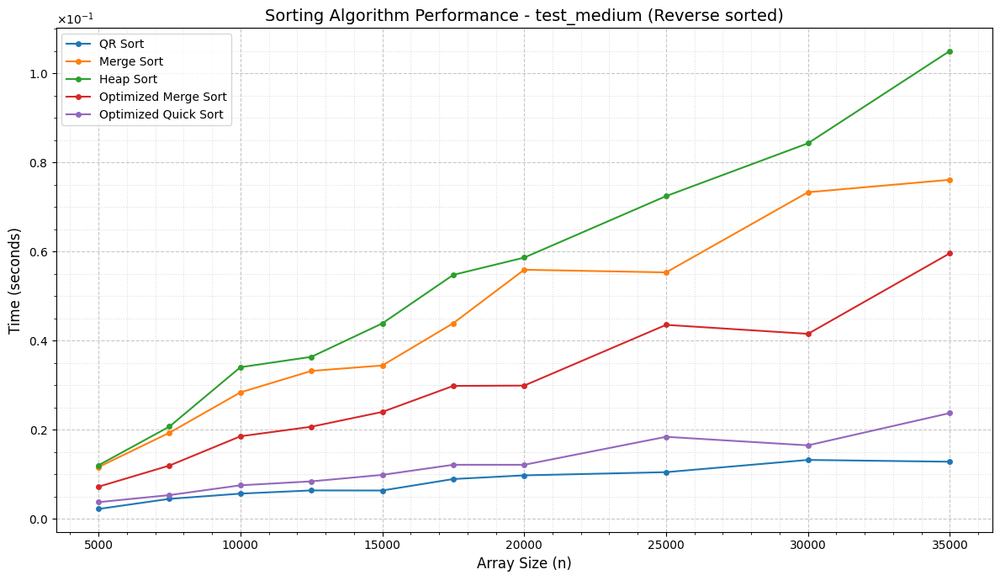


 Summary for test_medium (Reverse sorted) 
QR Sort: avg=8.052080e-03s, min=2.242300e-03s, max=1.324290e-02s
Merge Sort: avg=4.315402e-02s, min=1.164170e-02s, max=7.609260e-02s
Heap Sort: avg=5.221334e-02s, min=1.204030e-02s, max=1.049994e-01s
Optimized Merge Sort: avg=2.869013e-02s, min=7.236000e-03s, max=5.960260e-02s
Optimized Quick Sort: avg=1.179839e-02s, min=3.768700e-03s, max=2.375410e-02s

!!! Running test_large | Input: Reverse sorted
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


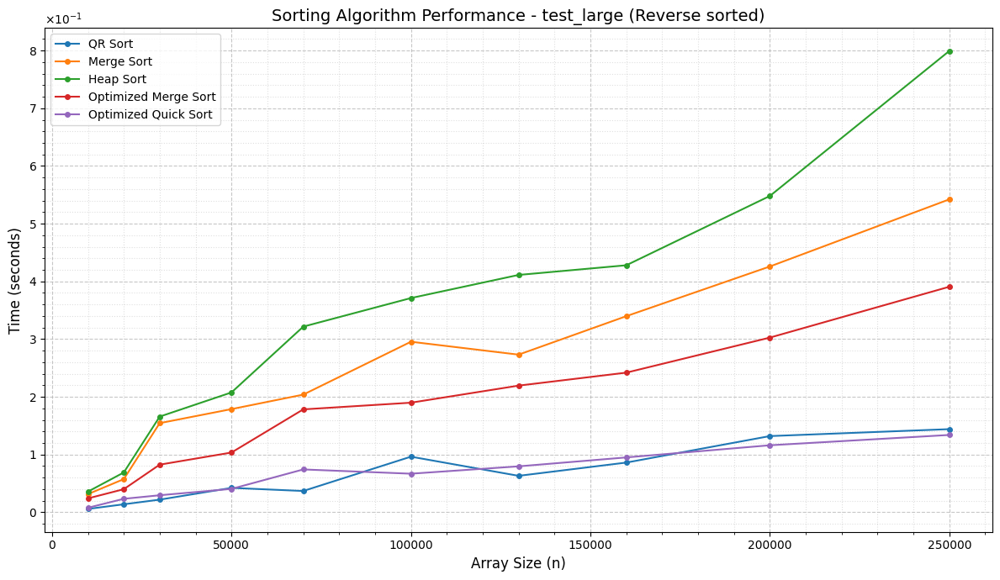


 Summary for test_large (Reverse sorted) 
QR Sort: avg=6.415584e-02s, min=5.677900e-03s, max=1.439686e-01s
Merge Sort: avg=2.501741e-01s, min=3.133480e-02s, max=5.421619e-01s
Heap Sort: avg=3.356978e-01s, min=3.565660e-02s, max=7.993389e-01s
Optimized Merge Sort: avg=1.772335e-01s, min=2.394400e-02s, max=3.907230e-01s
Optimized Quick Sort: avg=6.661897e-02s, min=7.745600e-03s, max=1.339051e-01s

!!! Running test_xl | Input: Reverse sorted
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


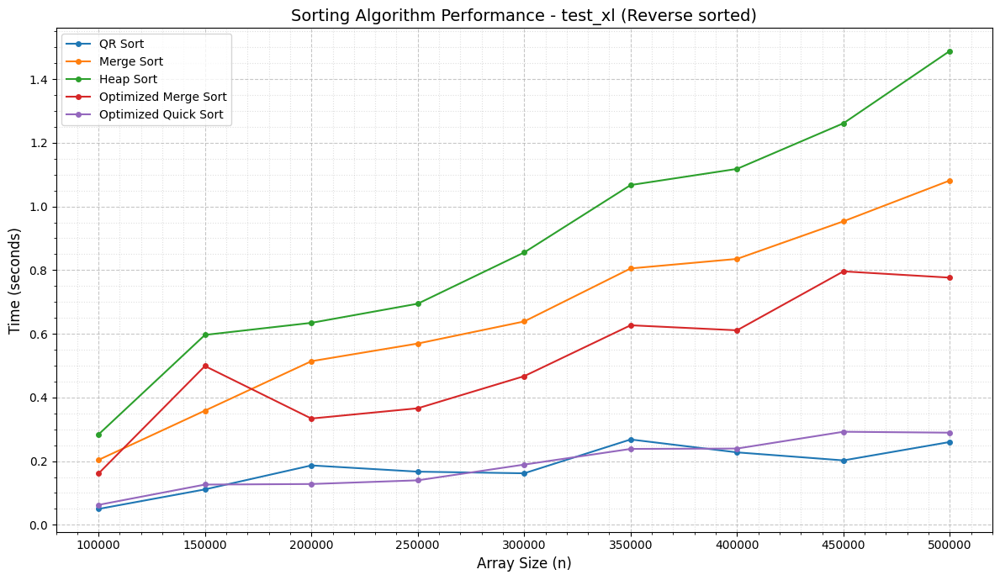


 Summary for test_xl (Reverse sorted) 
QR Sort: avg=1.816105e-01s, min=4.981830e-02s, max=2.680349e-01s
Merge Sort: avg=6.622049e-01s, min=2.038569e-01s, max=1.081562e+00s
Heap Sort: avg=8.888314e-01s, min=2.838055e-01s, max=1.488479e+00s
Optimized Merge Sort: avg=5.151846e-01s, min=1.610897e-01s, max=7.960496e-01s
Optimized Quick Sort: avg=1.895237e-01s, min=6.261590e-02s, max=2.922960e-01s

!!! Running test_xxl | Input: Reverse sorted
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


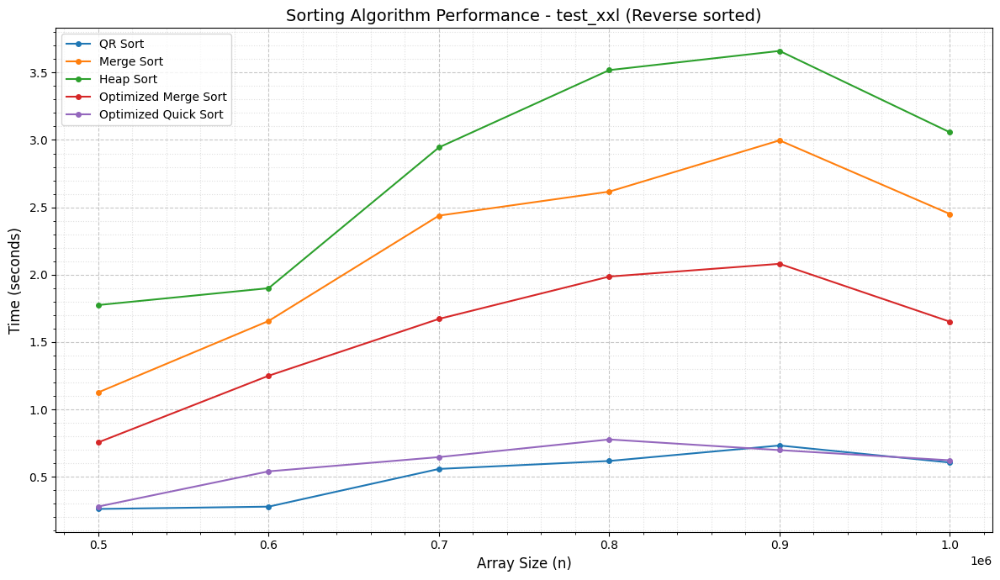


 Summary for test_xxl (Reverse sorted) 
QR Sort: avg=5.086707e-01s, min=2.609836e-01s, max=7.319978e-01s
Merge Sort: avg=2.214155e+00s, min=1.126499e+00s, max=2.996781e+00s
Heap Sort: avg=2.809112e+00s, min=1.774557e+00s, max=3.660714e+00s
Optimized Merge Sort: avg=1.565732e+00s, min=7.555216e-01s, max=2.080411e+00s
Optimized Quick Sort: avg=5.936390e-01s, min=2.790424e-01s, max=7.768815e-01s


In [53]:
def run_all_comparisons():
    all_algorithms = [
        ("QR Sort", Alg.run_qr),
        ("Merge Sort", Alg.run_merge),
        ("Quick Sort", Alg.run_quick),
        ("Heap Sort", Alg.run_heap),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

    # All except basic Quick Sort (it degrades to O(n^2) on sorted/reverse input)
    without_basic_quick = [
        ("QR Sort", Alg.run_qr),
        ("Merge Sort", Alg.run_merge),
        ("Heap Sort", Alg.run_heap),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

    without_basic_sorts = [
        ("QR Sort", Alg.run_qr),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

    all_test_sets = [
        ("test_small", test_small),
        ("test_medium", test_medium),
        ("test_large", test_large),
        ("test_xl", test_xl),
        ("test_xxl", test_xxl),
    ]

    # RANDOM INPUT
    print("#  RANDOM INPUT - All 6 algorithms on all 6 test sets")

    for name, sizes in all_test_sets:
        compare_and_plot(name, sizes, all_algorithms,
                         generate_random_array, "Random")
        
    # Additional for the best algs
    compare_and_plot("test_xxl", test_xxl, without_basic_sorts,
                     generate_random_array, "Random")
    compare_and_plot("test_xxxl", test_xxxl, without_basic_sorts,
                     generate_random_array, "Random")

    # SORTED INPUT (ascending)
    print("#  SORTED INPUT (ascending) - All 6 algorithms on all 6 test sets")
    print("#  Note: Basic Quick Sort included only on test_small (O(n^2) worst case)")

    # test_small with all 6 — shows Quick Sort O(n^2) degradation clearly
    compare_and_plot("test_small", test_small, all_algorithms,
                     generate_sorted_array, "Sorted (ascending)")

    # test_medium and above — exclude basic Quick Sort to avoid O(n^2) blowup
    for name, sizes in all_test_sets[1:]:
        compare_and_plot(name, sizes, without_basic_quick,
                         generate_sorted_array, "Sorted (ascending)")

    # REVERSE SORTED INPUT (descending)
    print("#  REVERSE SORTED INPUT (descending) - All 6 algorithms on all 6 test sets")
    print("#  Note: Basic Quick Sort included only on test_small (O(n^2) worst case)")

    # test_small with all 6
    compare_and_plot("test_small", test_small, all_algorithms,
                     generate_reverse_sorted_array, "Reverse sorted")

    # test_medium and above — exclude basic Quick Sort
    for name, sizes in all_test_sets[1:]:
        compare_and_plot(name, sizes, without_basic_quick,
                         generate_reverse_sorted_array, "Reverse sorted")

run_all_comparisons()


!!! Running test_xxxl | Input: Random
Sizes: [1500000, 2000000, 2500000, 5000000, 7500000, 10000000]
Algorithms: ['QR Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


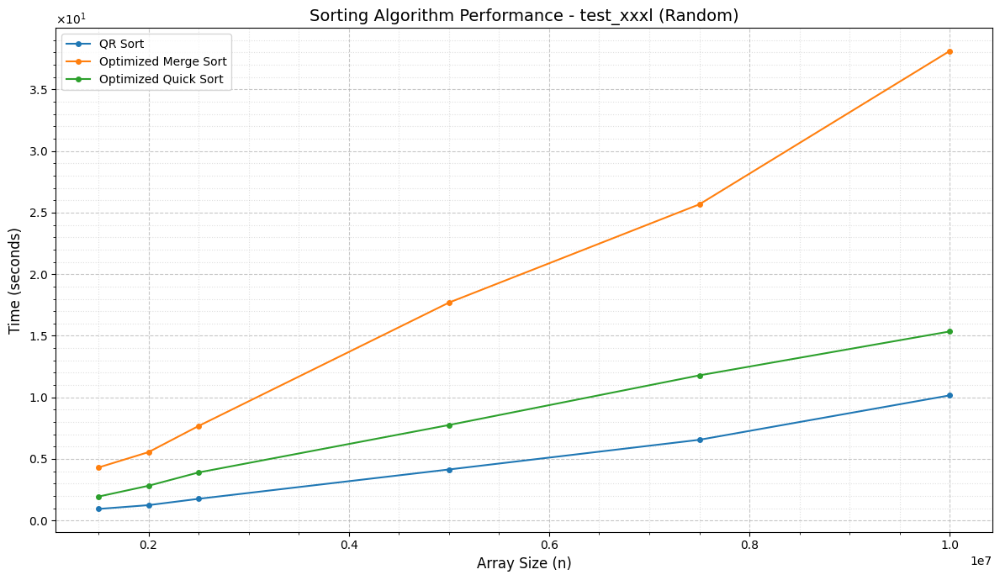


 Summary for test_xxxl (Random) 
QR Sort: avg=4.135436e+00s, min=9.393092e-01s, max=1.016318e+01s
Optimized Merge Sort: avg=1.650391e+01s, min=4.302579e+00s, max=3.812826e+01s
Optimized Quick Sort: avg=7.259487e+00s, min=1.941592e+00s, max=1.535206e+01s


In [54]:
without_basic_sorts = [
        ("QR Sort", Alg.run_qr),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

compare_and_plot("test_xxxl", test_xxxl, without_basic_sorts,
                     generate_random_array, "Random")


!!! Running test_xxxxl | Input: Random
Sizes: [15000000, 20000000, 25000000, 50000000, 75000000, 100000000]
Algorithms: ['QR Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


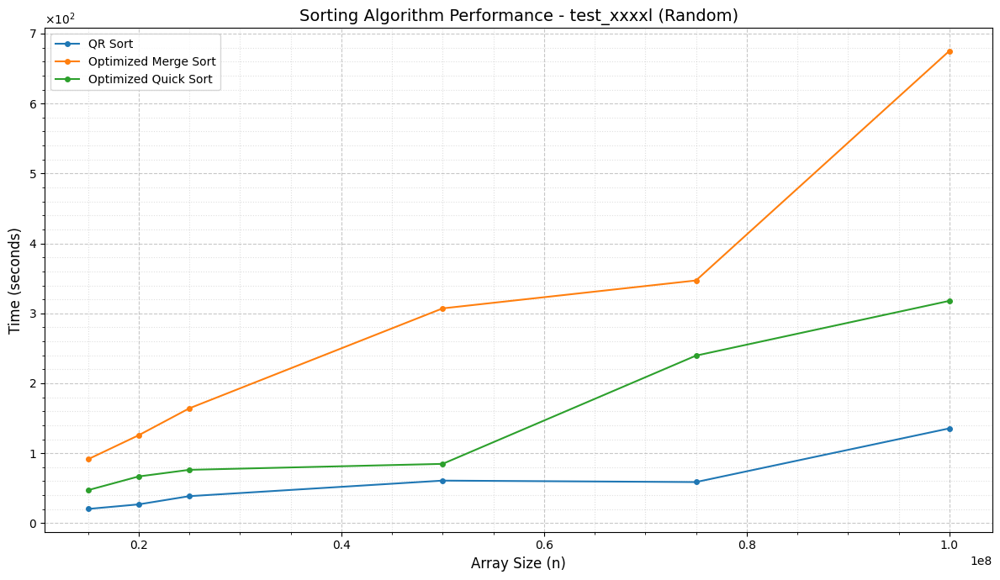


 Summary for test_xxxxl (Random) 
QR Sort: avg=5.685385e+01s, min=2.036281e+01s, max=1.355474e+02s
Optimized Merge Sort: avg=2.850850e+02s, min=9.131494e+01s, max=6.752052e+02s
Optimized Quick Sort: avg=1.387503e+02s, min=4.717179e+01s, max=3.178564e+02s


In [55]:
without_basic_sorts = [
        ("QR Sort", Alg.run_qr),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

compare_and_plot("test_xxxxl", test_xxxxl, without_basic_sorts,
                     generate_random_array, "Random")

# PARTIALLY SORTED INPUT (30%, 50%, 70% pre-sorted ascending)
# Quick Sort included only on test_small (may degrade on near-sorted data)


!!! Running test_small | Input: Partially sorted (30%)
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


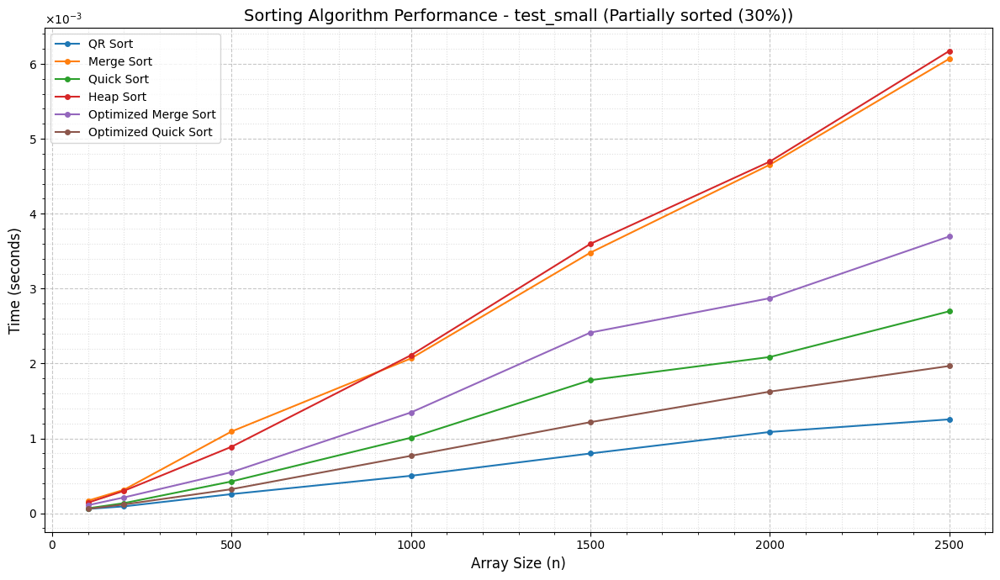


 Summary for test_small (Partially sorted (30%)) 
QR Sort: avg=5.776571e-04s, min=5.770000e-05s, max=1.253900e-03s
Merge Sort: avg=2.549071e-03s, min=1.678000e-04s, max=6.069300e-03s
Quick Sort: avg=1.170886e-03s, min=6.620000e-05s, max=2.697500e-03s
Heap Sort: avg=2.557900e-03s, min=1.413000e-04s, max=6.173500e-03s
Optimized Merge Sort: avg=1.599214e-03s, min=1.078000e-04s, max=3.696500e-03s
Optimized Quick Sort: avg=8.675000e-04s, min=5.890000e-05s, max=1.966700e-03s

!!! Running test_medium | Input: Partially sorted (30%)
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


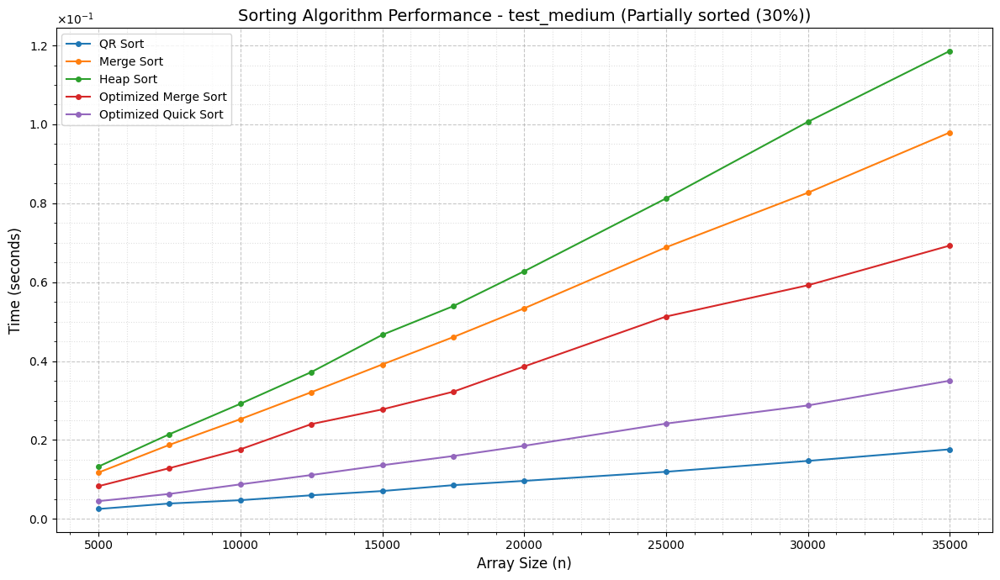


 Summary for test_medium (Partially sorted (30%)) 
QR Sort: avg=8.673090e-03s, min=2.526200e-03s, max=1.763910e-02s
Merge Sort: avg=4.760383e-02s, min=1.176180e-02s, max=9.795240e-02s
Heap Sort: avg=5.650471e-02s, min=1.327740e-02s, max=1.186150e-01s
Optimized Merge Sort: avg=3.412810e-02s, min=8.298400e-03s, max=6.928680e-02s
Optimized Quick Sort: avg=1.667773e-02s, min=4.510200e-03s, max=3.503740e-02s

!!! Running test_large | Input: Partially sorted (30%)
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


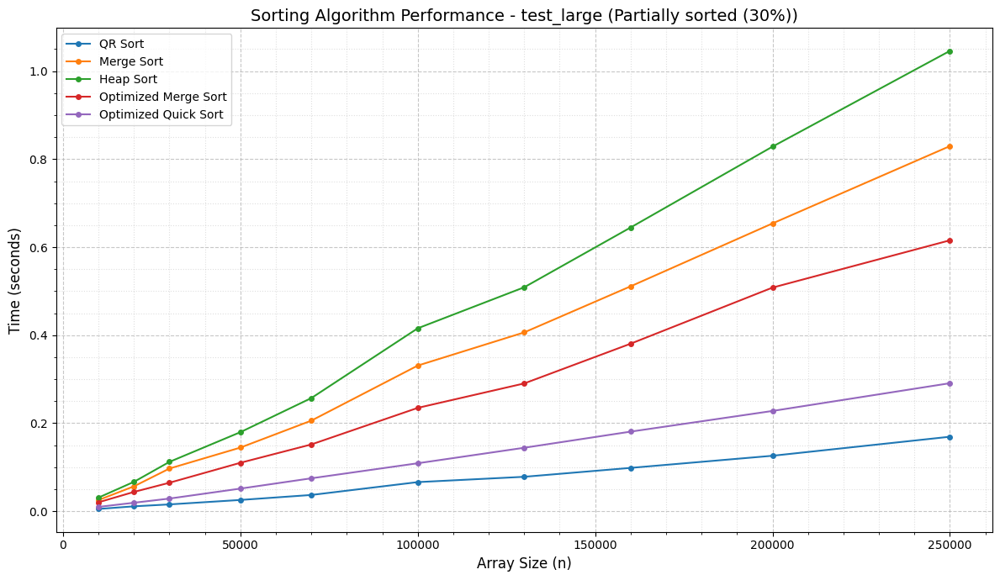


 Summary for test_large (Partially sorted (30%)) 
QR Sort: avg=6.322255e-02s, min=5.127500e-03s, max=1.692364e-01s
Merge Sort: avg=3.261430e-01s, min=2.536250e-02s, max=8.296674e-01s
Heap Sort: avg=4.090529e-01s, min=3.093740e-02s, max=1.046028e+00s
Optimized Merge Sort: avg=2.420291e-01s, min=2.027870e-02s, max=6.155951e-01s
Optimized Quick Sort: avg=1.136735e-01s, min=9.801900e-03s, max=2.908792e-01s

!!! Running test_xl | Input: Partially sorted (30%)
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


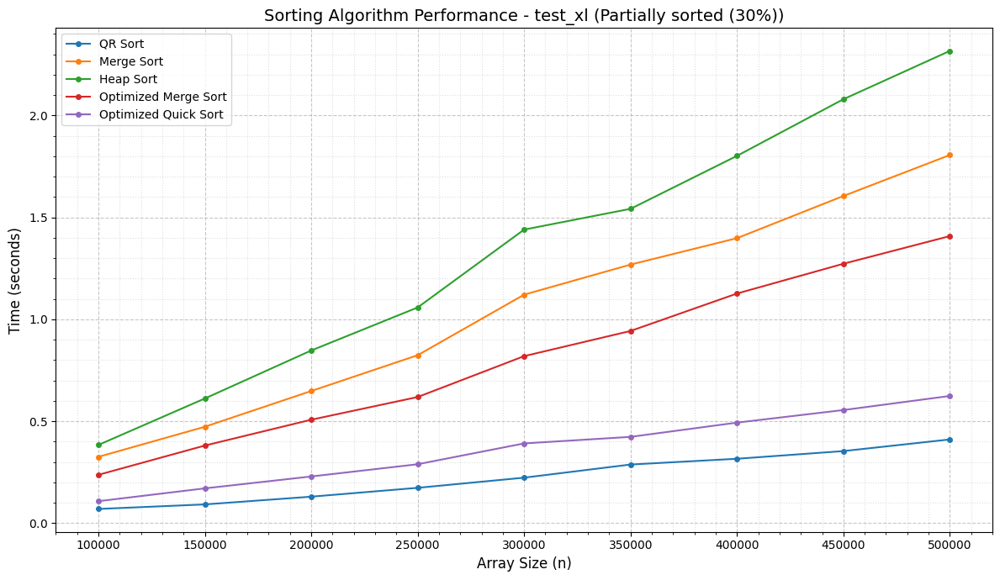


 Summary for test_xl (Partially sorted (30%)) 
QR Sort: avg=2.280248e-01s, min=6.923250e-02s, max=4.103504e-01s
Merge Sort: avg=1.051927e+00s, min=3.248797e-01s, max=1.806078e+00s
Heap Sort: avg=1.342232e+00s, min=3.832867e-01s, max=2.316897e+00s
Optimized Merge Sort: avg=8.123609e-01s, min=2.366115e-01s, max=1.408261e+00s
Optimized Quick Sort: avg=3.644093e-01s, min=1.072820e-01s, max=6.237215e-01s

!!! Running test_xxl | Input: Partially sorted (30%)
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


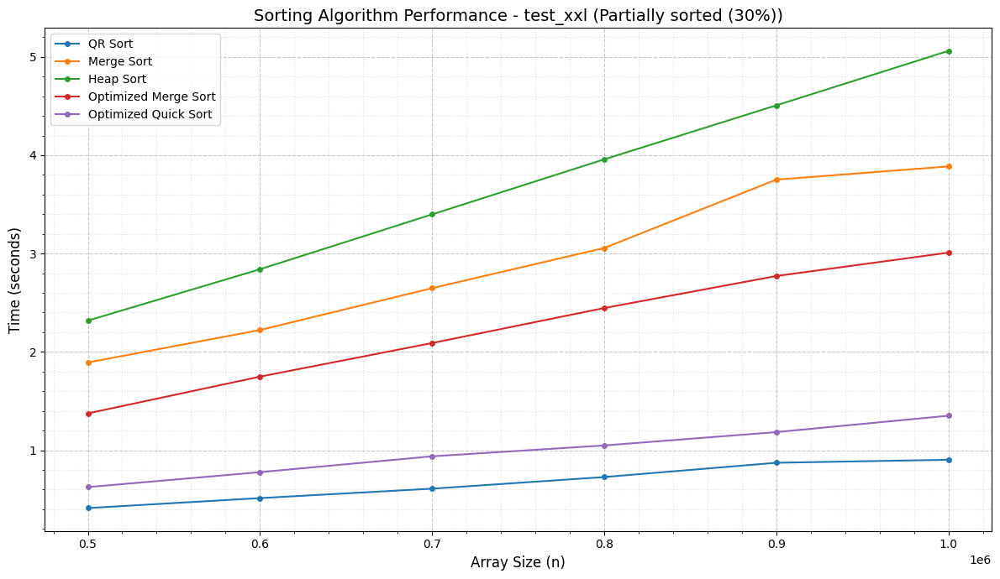


 Summary for test_xxl (Partially sorted (30%)) 
QR Sort: avg=6.728289e-01s, min=4.117670e-01s, max=9.029831e-01s
Merge Sort: avg=2.909532e+00s, min=1.892302e+00s, max=3.885853e+00s
Heap Sort: avg=3.680501e+00s, min=2.317922e+00s, max=5.061483e+00s
Optimized Merge Sort: avg=2.239980e+00s, min=1.374458e+00s, max=3.009508e+00s
Optimized Quick Sort: avg=9.873472e-01s, min=6.250129e-01s, max=1.351079e+00s

!!! Running test_small | Input: Partially sorted (50%)
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


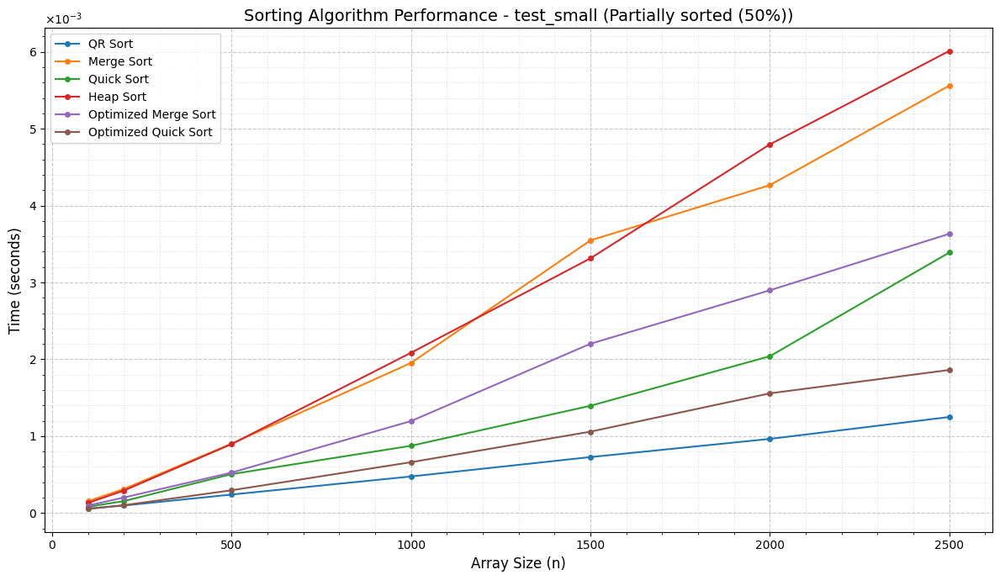


 Summary for test_small (Partially sorted (50%)) 
QR Sort: avg=5.440429e-04s, min=5.710000e-05s, max=1.249000e-03s
Merge Sort: avg=2.384714e-03s, min=1.523000e-04s, max=5.561700e-03s
Quick Sort: avg=1.205457e-03s, min=7.980000e-05s, max=3.389600e-03s
Heap Sort: avg=2.503671e-03s, min=1.305000e-04s, max=6.012900e-03s
Optimized Merge Sort: avg=1.535800e-03s, min=9.580000e-05s, max=3.633000e-03s
Optimized Quick Sort: avg=7.978571e-04s, min=5.230000e-05s, max=1.861000e-03s

!!! Running test_medium | Input: Partially sorted (50%)
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


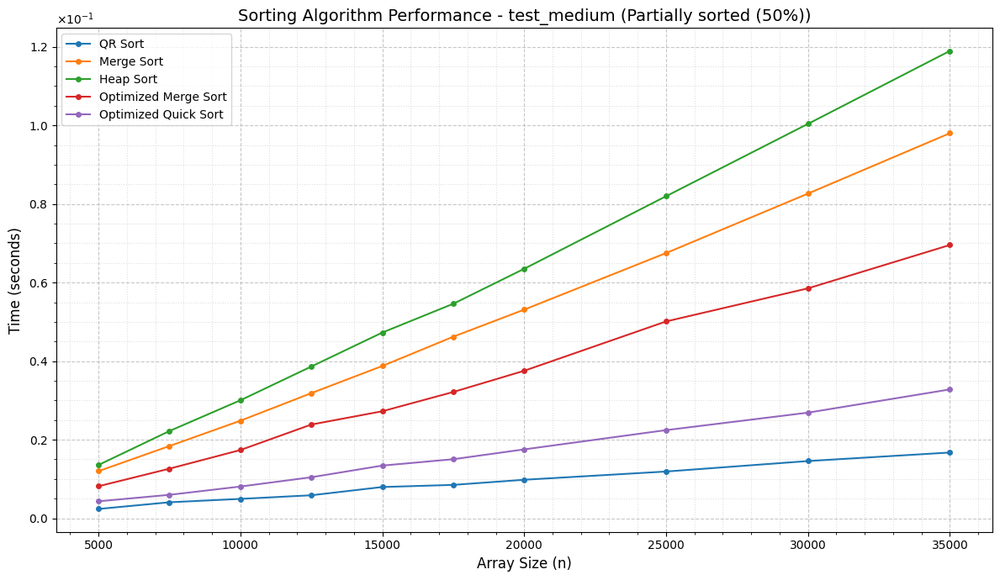


 Summary for test_medium (Partially sorted (50%)) 
QR Sort: avg=8.677480e-03s, min=2.380700e-03s, max=1.674360e-02s
Merge Sort: avg=4.733950e-02s, min=1.200720e-02s, max=9.801540e-02s
Heap Sort: avg=5.712156e-02s, min=1.357450e-02s, max=1.189666e-01s
Optimized Merge Sort: avg=3.371946e-02s, min=8.160500e-03s, max=6.956470e-02s
Optimized Quick Sort: avg=1.569920e-02s, min=4.330300e-03s, max=3.280430e-02s

!!! Running test_large | Input: Partially sorted (50%)
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


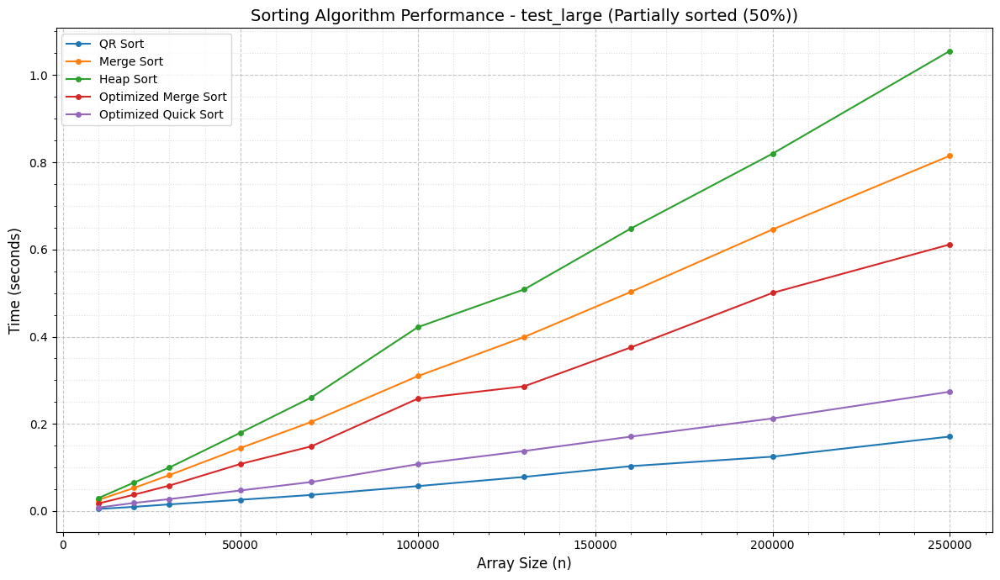


 Summary for test_large (Partially sorted (50%)) 
QR Sort: avg=6.272270e-02s, min=4.861800e-03s, max=1.709593e-01s
Merge Sort: avg=3.182817e-01s, min=2.563920e-02s, max=8.149964e-01s
Heap Sort: avg=4.088805e-01s, min=2.986520e-02s, max=1.055479e+00s
Optimized Merge Sort: avg=2.401239e-01s, min=1.743820e-02s, max=6.116018e-01s
Optimized Quick Sort: avg=1.070459e-01s, min=8.006800e-03s, max=2.737656e-01s

!!! Running test_xl | Input: Partially sorted (50%)
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


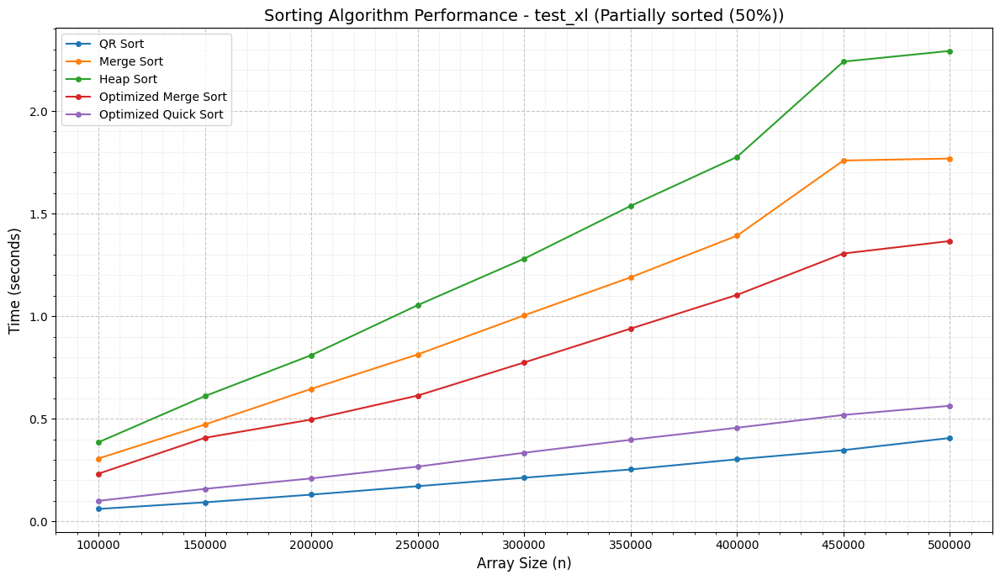


 Summary for test_xl (Partially sorted (50%)) 
QR Sort: avg=2.196052e-01s, min=6.050010e-02s, max=4.062651e-01s
Merge Sort: avg=1.038807e+00s, min=3.061751e-01s, max=1.768259e+00s
Heap Sort: avg=1.331657e+00s, min=3.852839e-01s, max=2.292635e+00s
Optimized Merge Sort: avg=8.040629e-01s, min=2.321941e-01s, max=1.366151e+00s
Optimized Quick Sort: avg=3.338208e-01s, min=1.000001e-01s, max=5.632515e-01s

!!! Running test_xxl | Input: Partially sorted (50%)
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


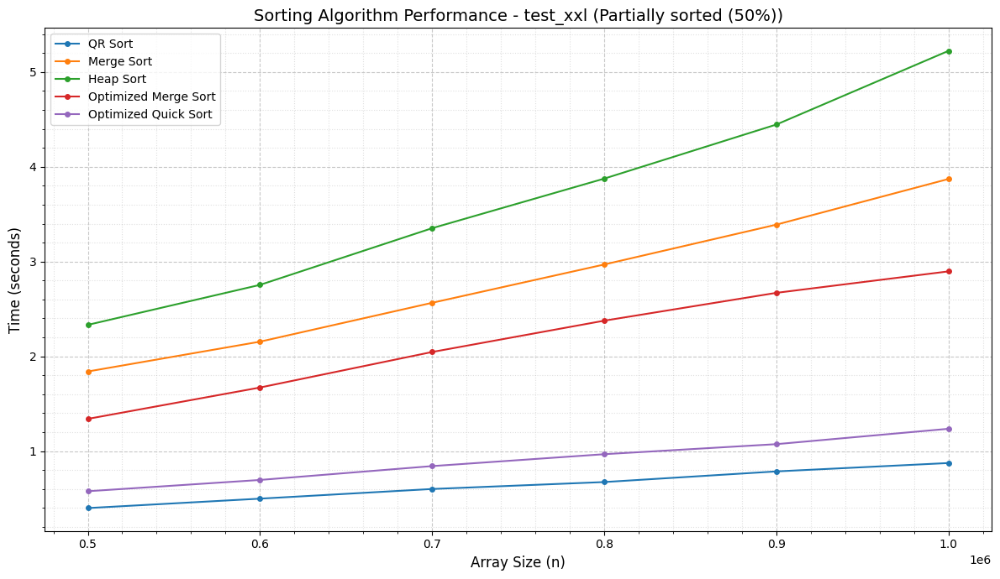


 Summary for test_xxl (Partially sorted (50%)) 
QR Sort: avg=6.377624e-01s, min=3.980686e-01s, max=8.735696e-01s
Merge Sort: avg=2.798372e+00s, min=1.839843e+00s, max=3.871972e+00s
Heap Sort: avg=3.664182e+00s, min=2.331921e+00s, max=5.224450e+00s
Optimized Merge Sort: avg=2.166407e+00s, min=1.339626e+00s, max=2.896565e+00s
Optimized Quick Sort: avg=8.977872e-01s, min=5.758995e-01s, max=1.235103e+00s

!!! Running test_small | Input: Partially sorted (70%)
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


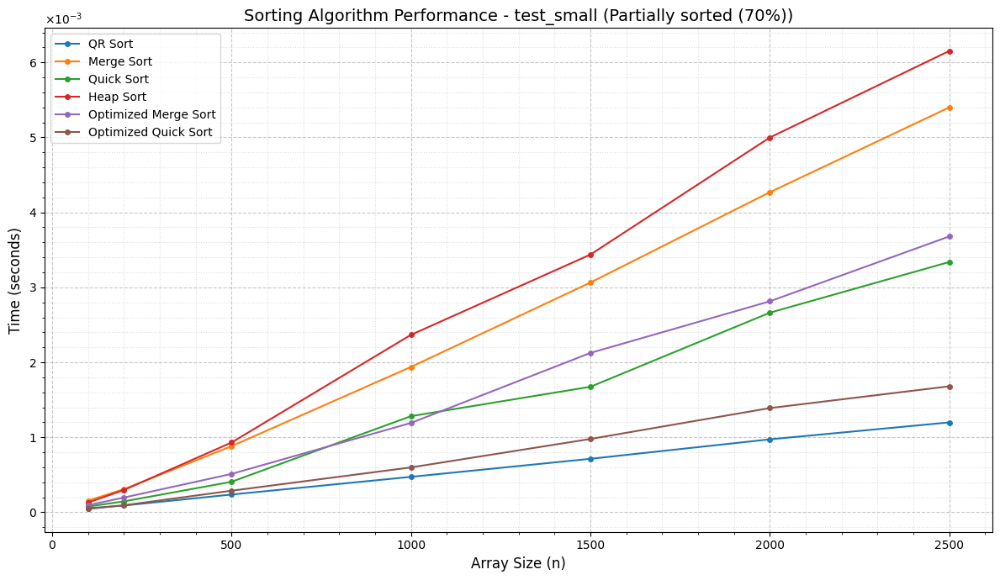


 Summary for test_small (Partially sorted (70%)) 
QR Sort: avg=5.343143e-04s, min=5.440000e-05s, max=1.198900e-03s
Merge Sort: avg=2.288086e-03s, min=1.555000e-04s, max=5.400100e-03s
Quick Sort: avg=1.369271e-03s, min=7.680000e-05s, max=3.338200e-03s
Heap Sort: avg=2.615871e-03s, min=1.294000e-04s, max=6.152900e-03s
Optimized Merge Sort: avg=1.516043e-03s, min=9.440000e-05s, max=3.679200e-03s
Optimized Quick Sort: avg=7.247714e-04s, min=4.470000e-05s, max=1.680400e-03s

!!! Running test_medium | Input: Partially sorted (70%)
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


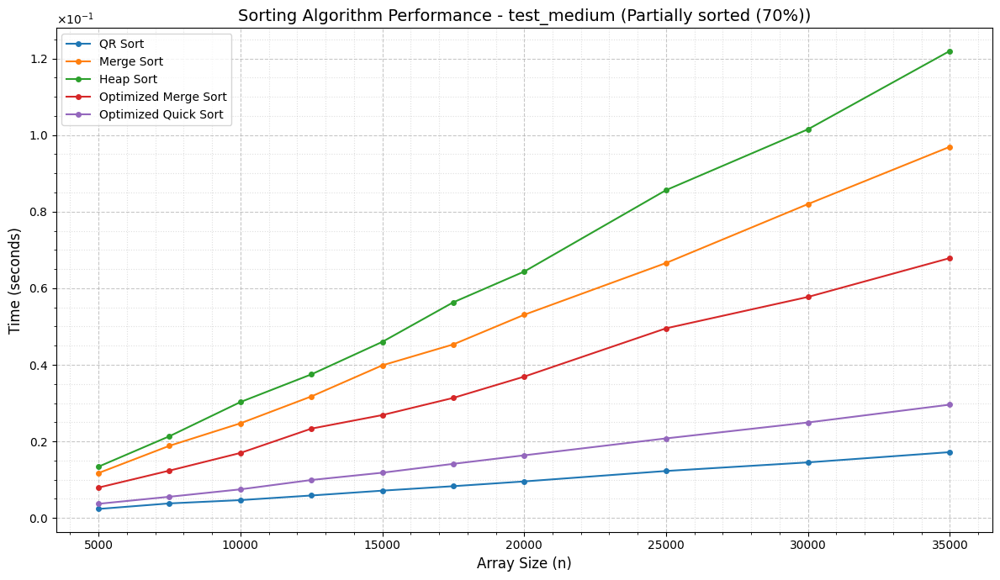


 Summary for test_medium (Partially sorted (70%)) 
QR Sort: avg=8.574500e-03s, min=2.364500e-03s, max=1.720230e-02s
Merge Sort: avg=4.708703e-02s, min=1.174200e-02s, max=9.694300e-02s
Heap Sort: avg=5.783521e-02s, min=1.341060e-02s, max=1.219753e-01s
Optimized Merge Sort: avg=3.309598e-02s, min=7.944100e-03s, max=6.787900e-02s
Optimized Quick Sort: avg=1.443606e-02s, min=3.711500e-03s, max=2.960740e-02s

!!! Running test_large | Input: Partially sorted (70%)
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


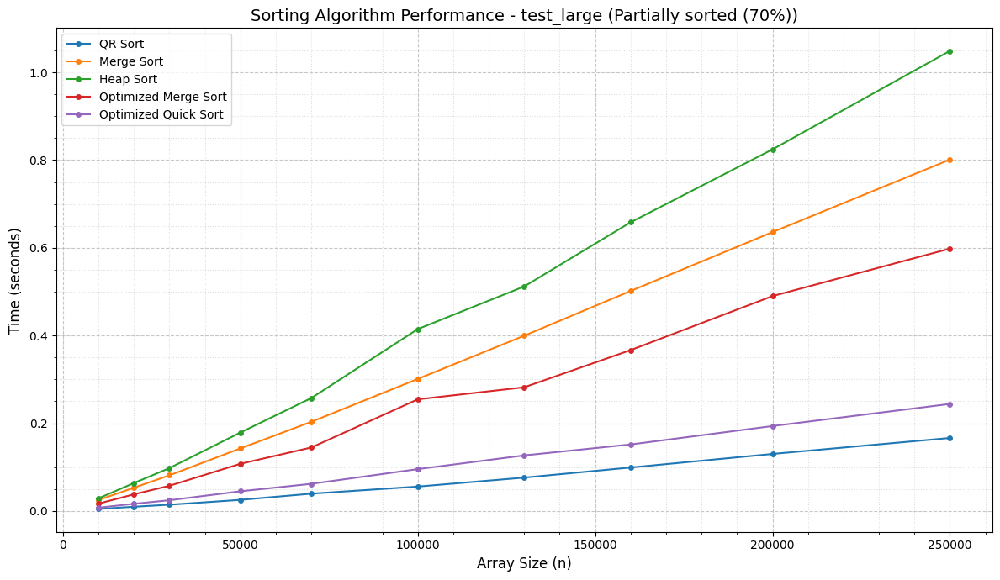


 Summary for test_large (Partially sorted (70%)) 
QR Sort: avg=6.216876e-02s, min=4.707100e-03s, max=1.665232e-01s
Merge Sort: avg=3.145161e-01s, min=2.515610e-02s, max=8.010682e-01s
Heap Sort: avg=4.085312e-01s, min=2.898560e-02s, max=1.048882e+00s
Optimized Merge Sort: avg=2.356652e-01s, min=1.688840e-02s, max=5.981329e-01s
Optimized Quick Sort: avg=9.675597e-02s, min=7.637500e-03s, max=2.440594e-01s

!!! Running test_xl | Input: Partially sorted (70%)
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


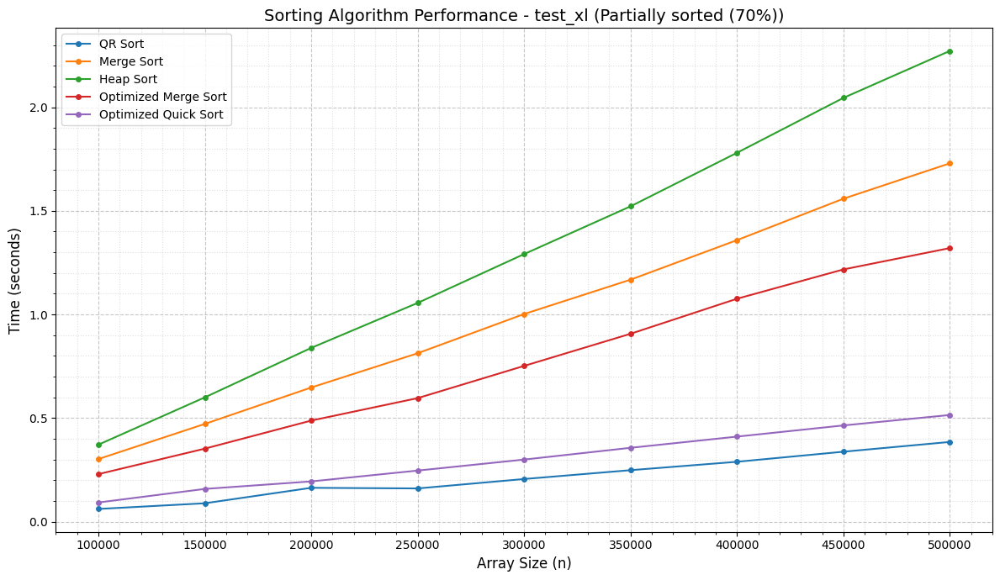


 Summary for test_xl (Partially sorted (70%)) 
QR Sort: avg=2.153983e-01s, min=6.124320e-02s, max=3.846570e-01s
Merge Sort: avg=1.005574e+00s, min=3.019819e-01s, max=1.729407e+00s
Heap Sort: avg=1.308419e+00s, min=3.713669e-01s, max=2.271909e+00s
Optimized Merge Sort: avg=7.707822e-01s, min=2.292107e-01s, max=1.320329e+00s
Optimized Quick Sort: avg=3.040285e-01s, min=9.239950e-02s, max=5.147214e-01s

!!! Running test_xxl | Input: Partially sorted (70%)
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


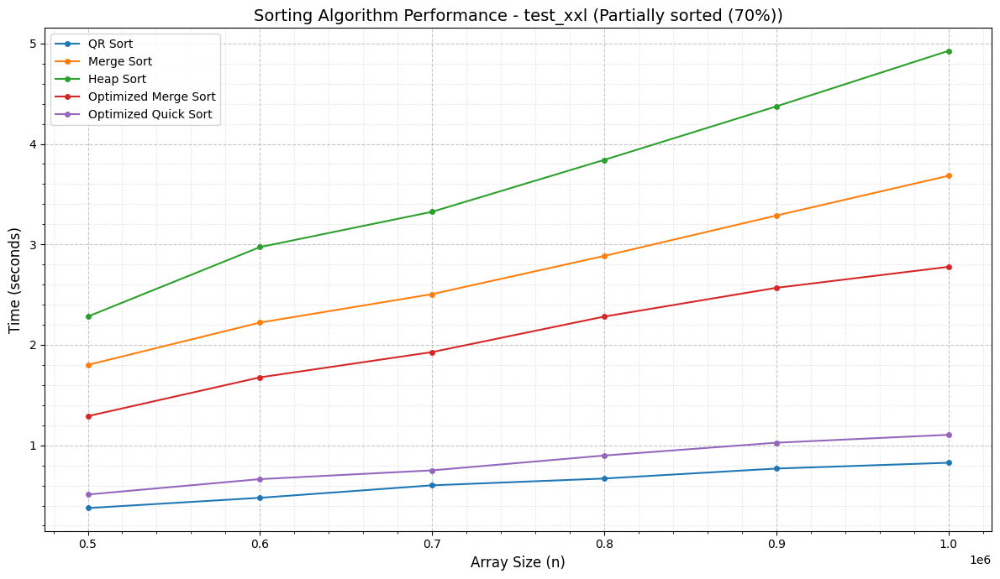


 Summary for test_xxl (Partially sorted (70%)) 
QR Sort: avg=6.199065e-01s, min=3.753014e-01s, max=8.265729e-01s
Merge Sort: avg=2.730452e+00s, min=1.800220e+00s, max=3.683206e+00s
Heap Sort: avg=3.620300e+00s, min=2.282016e+00s, max=4.926739e+00s
Optimized Merge Sort: avg=2.086768e+00s, min=1.290180e+00s, max=2.776537e+00s
Optimized Quick Sort: avg=8.256075e-01s, min=5.103395e-01s, max=1.104785e+00s


In [56]:
# --- Partially Sorted Arrays (30–70% pre-sorted in ascending order) ---

def generate_partially_sorted_array(n, sorted_fraction):
    """
    Generate an array where `sorted_fraction` (0.0–1.0) of the elements
    are already in sorted (ascending) position, and the rest are random.
    """
    arr = list(range(n))  # perfectly sorted base
    num_to_shuffle = int(n * (1 - sorted_fraction))
    # Pick random indices to scramble
    indices = random.sample(range(n), num_to_shuffle)
    values = [arr[i] for i in indices]
    random.shuffle(values)
    for idx, val in zip(indices, values):
        arr[idx] = val
    return arr


all_algorithms = [
    ("QR Sort", Alg.run_qr),
    ("Merge Sort", Alg.run_merge),
    ("Quick Sort", Alg.run_quick),
    ("Heap Sort", Alg.run_heap),
    ("Optimized Merge Sort", Alg.run_optimized_merge),
    ("Optimized Quick Sort", Alg.run_optimized_quick),
]

without_basic_quick = [
    ("QR Sort", Alg.run_qr),
    ("Merge Sort", Alg.run_merge),
    ("Heap Sort", Alg.run_heap),
    ("Optimized Merge Sort", Alg.run_optimized_merge),
    ("Optimized Quick Sort", Alg.run_optimized_quick),
]

test_sets_up_to_xxl = [
    ("test_small", test_small),
    ("test_medium", test_medium),
    ("test_large", test_large),
    ("test_xl", test_xl),
    ("test_xxl", test_xxl),
]

sorted_fractions = [0.30, 0.50, 0.70]

print("# PARTIALLY SORTED INPUT (30%, 50%, 70% pre-sorted ascending)")
print("# Quick Sort included only on test_small (may degrade on near-sorted data)\n")

for frac in sorted_fractions:
    pct = int(frac * 100)
    gen = lambda n, f=frac: generate_partially_sorted_array(n, f)
    gen_name = f"Partially sorted ({pct}%)"

    # test_small with all 6 algorithms (including basic Quick Sort)
    compare_and_plot("test_small", test_small, all_algorithms, gen, gen_name)

    # test_medium and above — drop basic Quick Sort to stay safe
    for name, sizes in test_sets_up_to_xxl[1:]:
        compare_and_plot(name, sizes, without_basic_quick, gen, gen_name)


In [57]:
# --- Sorting Animation (generic - works with any sorting algorithm) ---

import matplotlib.animation as animation
from IPython.display import HTML


class TrackedArray(list):
    """
    A list subclass that records a snapshot every time an element is written.
    Works with any in-place sorting algorithm without modifications.
    """
    def __init__(self, data):
        super().__init__(data)
        self._snapshots = []

    def __setitem__(self, key, value):
        super().__setitem__(key, value)
        if isinstance(key, int):
            self._snapshots.append((list(self), key))


def animate_sort(algorithm, size, generator, seed=42):
    """
    Animate any sorting algorithm step-by-step as a bar chart.

    Parameters
    ----------
    algorithm : tuple (name: str, func: callable)
        e.g. ("Quick Sort", Alg.run_quick)
    size : int
        Number of elements to sort.
    generator : callable(n) -> list
        Array generator function.
    seed : int
        Random seed for reproducibility.

    Returns
    -------
    HTML animation playable in Jupyter / VS Code notebooks.
    """
    name, func = algorithm

    random.seed(seed)
    data = generator(size)

    arr = TrackedArray(data)
    initial_state = list(arr)

    # Run the sorting algorithm - every arr[i]=v write is recorded
    func(arr)

    snapshots = arr._snapshots

    # Subsample to ~400 frames max so the animation stays snappy
    max_frames = 400
    if len(snapshots) > max_frames:
        step = len(snapshots) / max_frames
        indices = sorted(set(int(i * step) for i in range(max_frames)))
        indices.append(len(snapshots) - 1)
        snapshots = [snapshots[i] for i in indices]

    # Build frame list: initial -> intermediate -> final sorted
    frames = [(initial_state, -1)] + snapshots + [(list(arr), -1)]

    fig, ax = plt.subplots(figsize=(12, 5))
    max_val = max(initial_state) * 1.1
    ax.set_ylim(0, max_val)

    bars = ax.bar(range(size), frames[0][0],
                  color='steelblue', edgecolor='black', linewidth=0.3)
    ax.set_title(f'{name} Animation  |  {size} elements', fontsize=14)
    ax.set_xlabel('Index')
    ax.set_ylabel('Value')

    info_text = ax.text(
        0.02, 0.95, '', transform=ax.transAxes,
        fontsize=10, verticalalignment='top', fontfamily='monospace',
        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

    def update(frame_idx):
        state, active_idx = frames[frame_idx]
        is_last = (frame_idx == len(frames) - 1)

        for i, bar in enumerate(bars):
            bar.set_height(state[i])
            if is_last:
                bar.set_color('limegreen')
            elif i == active_idx:
                bar.set_color('crimson')
            else:
                bar.set_color('steelblue')

        if is_last:
            info_text.set_text(f'Sorted!  ({len(frames) - 1} steps)')
        else:
            info_text.set_text(f'Step {frame_idx} / {len(frames) - 2}')

        return list(bars) + [info_text]

    interval = max(10, 5000 // len(frames))

    anim = animation.FuncAnimation(
        fig, update, frames=len(frames),
        interval=interval, blit=True, repeat=False
    )
    plt.close(fig)
    return HTML(anim.to_jshtml())


# --- Example usage ---
animate_sort(("Opt Merge Sort", Alg.run_optimized_merge), size=1000, generator=generate_random_array)